In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from scipy.cluster import hierarchy
from sklearn import preprocessing
import folium

In [3]:
# Clean EPC column
def extract_epc(value):
    if isinstance(value, str) and '_' in value:
        parts = value.split('_')
        return parts[-1]
    else:
        return value
    
def map_to_numerical(column, mapping):
    return column.map(mapping)

In [4]:
# Read the CSV file into a pandas DataFrame
immo = pd.read_csv('immo_all.csv')

#remove unnecessary columns
#immo_c = immo.drop(columns=["Unnamed: 0", "public_sales","notary_sales","country","id", "longitude", "latitude", "link"], axis=1)
immo_c = immo.drop(columns=["Unnamed: 0",  "link"], axis=1)


#df = df.drop(df.columns[[0, 1, 30, 31, 32, 33]], axis=1)

# Replace empty values with NaN
immo_c.replace('', pd.NA, inplace=True)

immo_c.head()


,locality,construction_year,Number_of_frontages,province,zip_code,price,property_type,subproperty_type,bedroom_count,total_area_m2,...,state_building,epc,primaryEnergyConsumptionPerSqm,heating_Type,Double_Glazing,cadastral_income,latitude,longitude,epc_n,state_building_n
0,Brugge,2013.0,NaN,West Flanders,8000,449000.0,APARTMENT,APARTMENT,3.0,129.0,...,GOOD,B,157.0,NaN,1,0.0,51.224569,3.193698,4.0,3.0
1,Brugge,2004.0,NaN,West Flanders,8000,865000.0,APARTMENT,PENTHOUSE,2.0,198.0,...,GOOD,B,106.0,NaN,1,1675.0,51.216909,3.206984,4.0,3.0
2,Brugge,2027.0,NaN,West Flanders,8000,471500.0,APARTMENT,APARTMENT,2.0,105.0,...,NaN,NaN,NaN,NaN,1,0.0,51.218103,3.210958,NaN,NaN
3,Brugge,1950.0,2.0,West Flanders,8000,315000.0,APARTMENT,APARTMENT,2.0,82.0,...,GOOD,B,121.0,GAS,1,0.0,51.220976,3.216877,4.0,3.0
4,Brugge,1965.0,NaN,West Flanders,8000,549000.0,APARTMENT,APARTMENT,2.0,138.0,...,NaN,B,135.0,GAS,1,971.0,51.210416,3.214247,4.0,NaN


In [ ]:
#clean  (0 means Nan in theas features)
#immo_c['cadastral_income'] = immo_c['cadastral_income'].replace(0, pd.NA)
#immo_c['surface_land'] = immo_c['surface_land'].replace(0, pd.NA)
#immo_c['primaryEnergyConsumptionPerSqm'] = immo_c['primaryEnergyConsumptionPerSqm'].replace(0, pd.NA)
#immo_c['total_area_m2'] = immo_c['total_area_m2'].replace(0, pd.NA)
#immo_c['price'] = immo_c['price'].replace(0, pd.NA)

In [ ]:
#clean EPC
immo_c['epc'] = immo_c['epc'].apply(extract_epc)
immo_c['epc'].value_counts().to_frame()


,count
epc,
B,11334
C,9565
A,8606
D,8068
F,7094
E,5849
G,3956
A+,879
A++,715


# How many observations and features do you have?


In [7]:
# Display the size of the Data
print("DataFrame size: ", immo_c.shape)

DataFrame size:  (34957, 32)


# What is the proportion of missing values per column?

C:\Users\Hazem\AppData\Local\Temp\ipykernel_6452\2197031495.py:9: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')


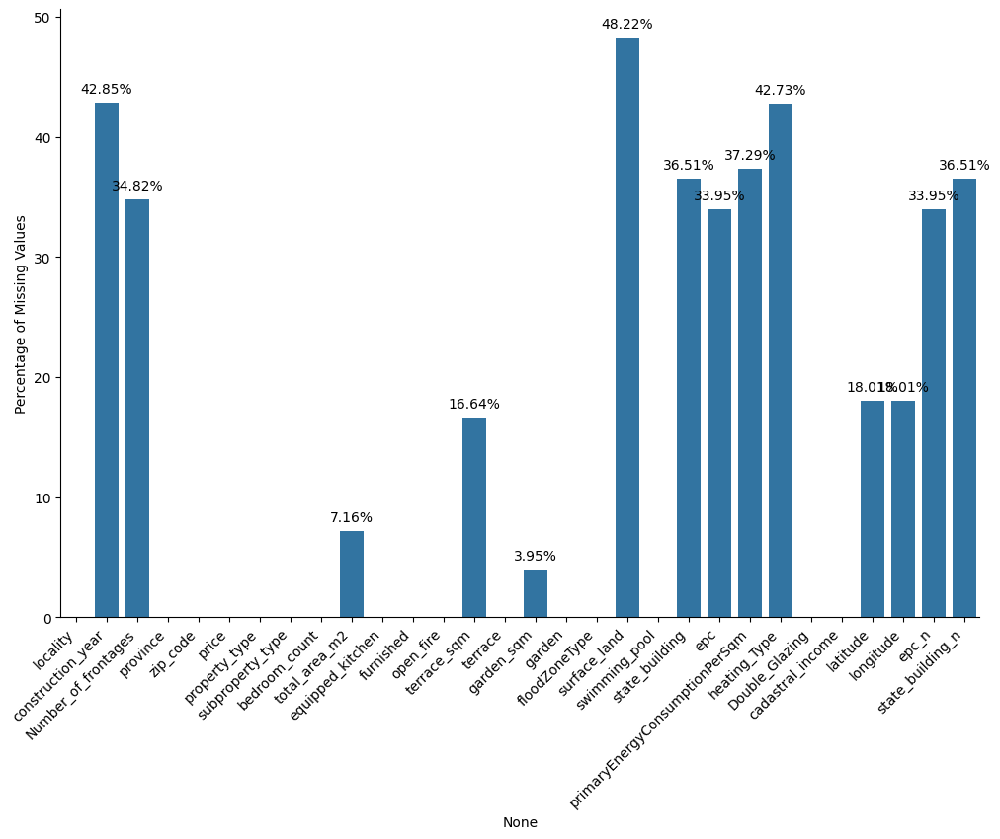

In [5]:
missing_values = immo_c.isnull().mean() * 100  # Calculate percentage of missing values


# Create a bar plot with percentages
plt.figure(figsize=(12, 8))
ax = sns.barplot(x=missing_values.index, y=missing_values.values)

# Rotate the x-axis tick labels
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

# Set y-axis label as percentage
plt.ylabel('Percentage of Missing Values')

# Show the percentage values on top of the bars for non-zero percentages
for p in ax.patches:
    if p.get_height() > 0.01:
        ax.annotate(f'{p.get_height():.2f}%', (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center', xytext=(0, 10), textcoords='offset points')
        

# Remove the lines on the top and right sides of the plot
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

plt.savefig('missing_values_plot.pdf', format='pdf', bbox_inches='tight')

plt.show()

C:\Users\Hazem\AppData\Local\Temp\ipykernel_6452\773797957.py:3: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  province_missing_values = immo_c[immo_c["property_type"]==1].groupby('province').apply(lambda x: x.isnull().mean() * 100)
C:\Users\Hazem\AppData\Local\Temp\ipykernel_6452\773797957.py:19: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')


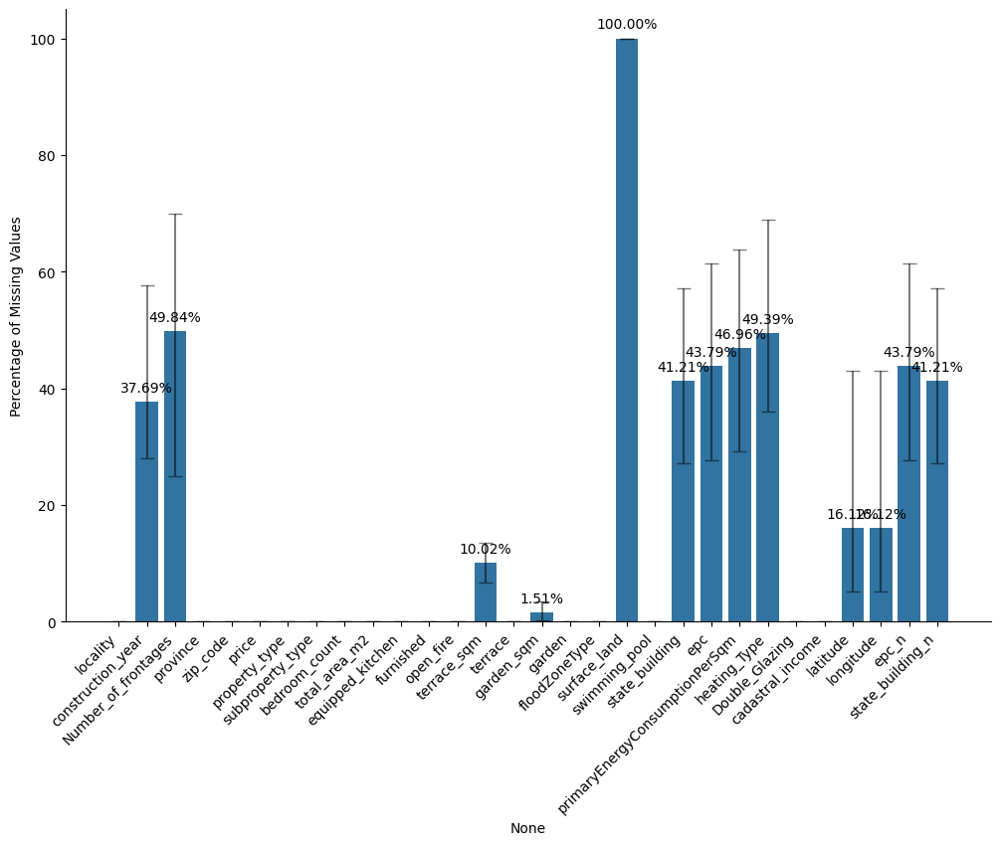

In [18]:
missing_values = immo_c[immo_c["property_type"]==1].isnull().mean() * 100  # Calculate percentage of missing values

province_missing_values = immo_c[immo_c["property_type"]==1].groupby('province').apply(lambda x: x.isnull().mean() * 100)

# Calculate the minimum and maximum percentage of missing values for each column and each province
min_values = province_missing_values.min().values
max_values = province_missing_values.max().values
mean_values = province_missing_values.mean()

# Ensure error bars don't extend below zero and above 100
lower_error = [max(0, val) for val in (mean_values.values - min_values)]
upper_error = [min(100, val) for val in (max_values - mean_values.values)]

# Create a bar plot with percentages
plt.figure(figsize=(12, 8))
ax = sns.barplot(x=missing_values.index, y=missing_values.values)

# Rotate the x-axis tick labels
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')

# Set y-axis label as percentage
plt.ylabel('Percentage of Missing Values')

# Show the percentage values on top of the bars for non-zero percentages
for p in ax.patches:
    if p.get_height() > 0.01:
        ax.annotate(f'{p.get_height():.2f}%', (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center', xytext=(0, 10), textcoords='offset points')

# Show error bars representing the minimum and maximum percentage of missing values across provinces
plt.errorbar(x=mean_values.index, y=mean_values.values,
             yerr=[lower_error, upper_error],
             fmt='none', color='black', capsize=5, alpha=0.5)

# Remove the lines on the top and right sides of the plot
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Save the plot as a PDF file
plt.savefig('missing_error_bars.pdf', format='pdf', bbox_inches='tight')

plt.show()


In [ ]:
province_missing_values

,locality,construction_year,Number_of_frontages,province,zip_code,price,property_type,subproperty_type,bedroom_count,total_area_m2,...,garden,floodZoneType,surface_land,swimming_pool,state_building,epc,primaryEnergyConsumptionPerSqm,heating_Type,Double_Glazing,cadastral_income
province,,,,,,,,,,,,,,,,,,,,,
Antwerp,0.0,32.297207,30.061503,0.0,0.0,0.016622,0.0,0.0,0.315824,7.862367,...,0.0,0.0,59.674202,0.0,36.826795,34.275266,37.948803,46.492686,0.0,63.356051
Brussels,0.0,34.792729,22.833075,0.0,0.0,0.000000,0.0,0.0,0.177344,5.519840,...,0.0,0.0,83.562403,0.0,26.989581,26.701397,29.583241,35.014409,0.0,70.450011
East Flanders,0.0,37.196339,43.144759,0.0,0.0,0.016639,0.0,0.0,0.582363,11.006656,...,0.0,0.0,45.474210,0.0,36.314476,46.988353,50.873544,53.993344,0.0,66.597338
Flemish Brabant,0.0,35.680994,31.615743,0.0,0.0,0.000000,0.0,0.0,0.517866,7.301916,...,0.0,0.0,47.061108,0.0,34.205075,41.960124,46.012429,44.886069,0.0,61.211807
Hainaut,0.0,68.415212,28.851004,0.0,0.0,0.040351,0.0,0.0,0.383335,16.402704,...,0.0,0.0,44.426511,0.0,37.486129,25.209321,32.876021,36.003228,0.0,51.376980
Limburg,0.0,30.996119,46.183700,0.0,0.0,0.000000,0.0,0.0,0.336352,10.375162,...,0.0,0.0,51.461837,0.0,48.434670,42.690815,51.435964,54.721863,0.0,63.622251
Liège,0.0,61.010645,26.099782,0.0,0.0,0.051302,0.0,0.0,0.282160,9.580608,...,0.0,0.0,49.557522,0.0,38.527639,23.149929,35.000641,31.807105,0.0,47.325895
Luxembourg,0.0,50.616793,32.073219,0.0,0.0,0.000000,0.0,0.0,0.795862,11.937923,...,0.0,0.0,43.334660,0.0,37.962595,21.130123,31.715082,33.863908,0.0,57.341823
Namur,0.0,57.540264,29.311859,0.0,0.0,0.029283,0.0,0.0,0.146413,9.282577,...,0.0,0.0,48.579795,0.0,38.360176,23.103953,29.077599,32.445095,0.0,54.846266


# How many qualitative and quantitative variables are there? How would you transform the qualitative values into numerical values?


In [6]:
#Custom mappings
epc_mapping = {'A++': 9, 'A+': 8, 'A': 7, 'B': 6, 'C': 5, 'D': 4, 'E': 3, 'F': 2, 'G': 1}
state_mapping = {'JUST_RENOVATED': 6, 'AS_NEW': 5, 'GOOD': 4, 'TO_BE_DONE_UP': 3, 'TO_RENOVATE': 2, 'TO_RESTORE': 1}
propert_type={'APARTMENT': 1, 'HOUSE': 0}
# Apply mappings to create new numerical columns
immo_c["epc"] = map_to_numerical(immo_c["epc"], epc_mapping)
immo_c["state_building"] = map_to_numerical(immo_c["state_building"], state_mapping)
immo_c["property_type"] = map_to_numerical(immo_c["property_type"], propert_type)

immo_c.head()

,locality,construction_year,Number_of_frontages,province,zip_code,price,property_type,subproperty_type,bedroom_count,total_area_m2,...,state_building,epc,primaryEnergyConsumptionPerSqm,heating_Type,Double_Glazing,cadastral_income,latitude,longitude,epc_n,state_building_n
0,Brugge,2013.0,NaN,West Flanders,8000,449000.0,1,APARTMENT,3.0,129.0,...,4.0,6.0,157.0,NaN,1,0.0,51.224569,3.193698,4.0,3.0
1,Brugge,2004.0,NaN,West Flanders,8000,865000.0,1,PENTHOUSE,2.0,198.0,...,4.0,6.0,106.0,NaN,1,1675.0,51.216909,3.206984,4.0,3.0
2,Brugge,2027.0,NaN,West Flanders,8000,471500.0,1,APARTMENT,2.0,105.0,...,NaN,NaN,NaN,NaN,1,0.0,51.218103,3.210958,NaN,NaN
3,Brugge,1950.0,2.0,West Flanders,8000,315000.0,1,APARTMENT,2.0,82.0,...,4.0,6.0,121.0,GAS,1,0.0,51.220976,3.216877,4.0,3.0
4,Brugge,1965.0,NaN,West Flanders,8000,549000.0,1,APARTMENT,2.0,138.0,...,NaN,6.0,135.0,GAS,1,971.0,51.210416,3.214247,4.0,NaN


In [11]:
immo_c['subproperty_type'].value_counts().to_frame()


,count
subproperty_type,
HOUSE,27618
VILLA,2599
APARTMENT_BLOCK,1398
MIXED_USE_BUILDING,1287
TOWN_HOUSE,443
EXCEPTIONAL_PROPERTY,362
MANSION,327
BUNGALOW,299
COUNTRY_COTTAGE,183


# Which variables would you delete and why?



-public_sales & notary_ sales -> no value country, link, id

# What variables are most subject to outliers?



# What is the correlation between the variables and the price? Why do you think some variables are more correlated than others?


In [50]:
print(immo_c.dtypes)


locality                           object
construction_year                 float64
Number_of_frontages               float64
province                           object
zip_code                            int64
price                             float64
property_type                       int64
subproperty_type                   object
bedroom_count                     float64
total_area_m2                     float64
equipped_kitchen                    int64
furnished                           int64
open_fire                           int64
terrace_sqm                       float64
terrace                             int64
garden_sqm                        float64
garden                              int64
floodZoneType                       int64
surface_land                      float64
swimming_pool                       int64
state_building                    float64
epc                               float64
primaryEnergyConsumptionPerSqm    float64
heating_Type                      

# How are the variables themselves correlated to each other? Can you find groups of variables that are correlated together?


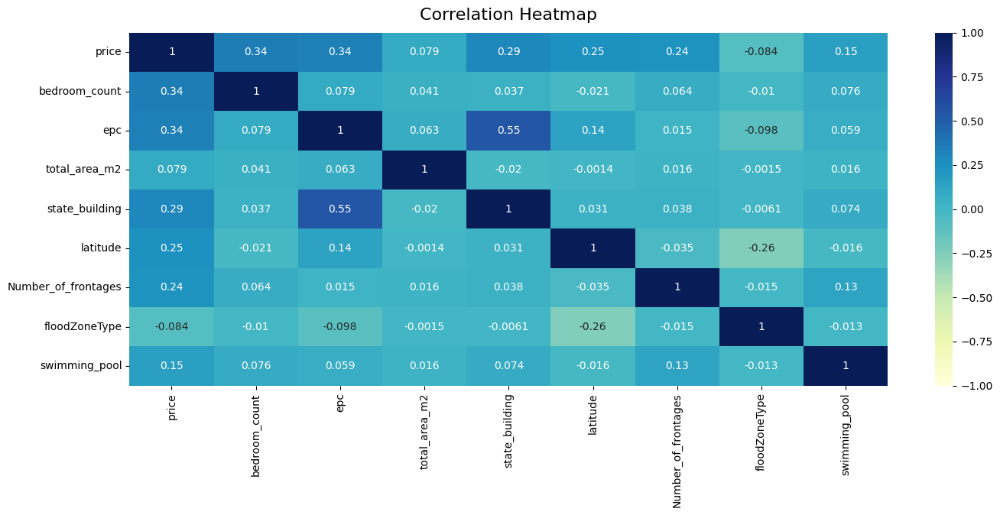

In [61]:
#remove unnecessary columns
immo_heat = immo_c[immo_c["property_type"]==1].drop(columns=["terrace_sqm"], axis=1)

# Select only numeric columns
numeric_columns = immo_heat.select_dtypes(include=['float64', 'int64'])

plt.figure(figsize=(16, 6))
heatmap = sns.heatmap(numeric_columns[['price','bedroom_count','epc','total_area_m2','state_building','latitude','Number_of_frontages','floodZoneType',"swimming_pool"]].corr(), vmin=-1, vmax=1, annot=True, cmap="YlGnBu")
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize': 16}, pad=12)
plt.show()

In [37]:
# Select only numeric columns
numeric_columns = immo_heat.select_dtypes(include=['float64', 'int64'])

# Calculate correlation matrix
correlation_matrix = numeric_columns.corr()

# Get the top 20 highest correlation values
top_correlations = correlation_matrix.unstack().sort_values(ascending=False).drop_duplicates().head(20)

# Filter out correlations with the same column names
top_correlations = top_correlations[top_correlations.index.map(lambda x: x[0] != x[1])]

print(top_correlations)


state_building_n     epc_n                  0.543175
surface_land         garden_sqm             0.375246
price                bedroom_count          0.362129
Unnamed: 0           longitude              0.331362
latitude             price                  0.250391
terrace              garden                 0.247621
price                Number_of_frontages    0.238989
garden               garden_sqm             0.236042
Double_Glazing       equipped_kitchen       0.229188
price                total_area_m2          0.227503
terrace              equipped_kitchen       0.217201
garden               equipped_kitchen       0.205062
price                surface_land           0.195367
floodZoneType        Unnamed: 0             0.193295
Number_of_frontages  surface_land           0.193188
open_fire            garden                 0.192648
Number_of_frontages  construction_year      0.174860
price                swimming_pool          0.157895
open_fire            equipped_kitchen       0.

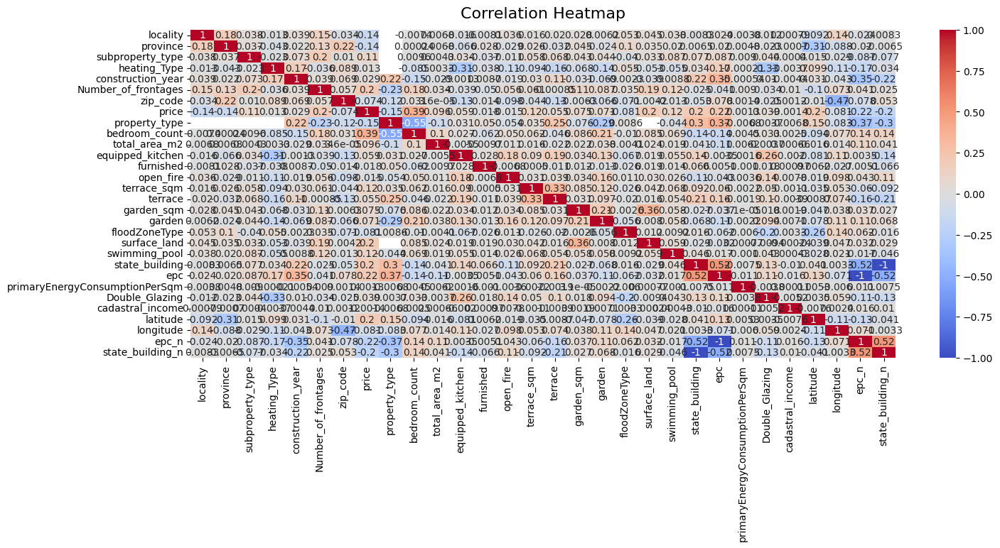

In [63]:
# Select only object-type columns
object_columns = immo_c[immo_c["property_type"]==0].select_dtypes(include=['object'])

# Convert non-numeric values to string
for column in object_columns.columns:
    object_columns[column] = object_columns[column].astype(str)

# Initialize LabelEncoder
label_encoder = preprocessing.LabelEncoder()

# Encode object-type columns
for column in object_columns.columns:
    object_columns[column] = label_encoder.fit_transform(object_columns[column])

# Combine encoded object columns with numeric columns
combined_data = pd.concat([object_columns, immo_c.select_dtypes(['float64', 'int64'])], axis=1)

# Calculate the correlation matrix
correlation_matrix = combined_data.corr()

# Create a heatmap
plt.figure(figsize=(16, 6))
heatmap = sns.heatmap(correlation_matrix, vmin=-1, vmax=1, annot=True, cmap='coolwarm')
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize': 16}, pad=12)
plt.show()


In [59]:
# Calculate correlation matrix
combined_data = pd.concat([object_columns, immo_c[immo_c["property_type"]==0].select_dtypes(['float64', 'int64'])], axis=1)
correlation_matrix = combined_data.corr()

# Get the top 20 highest correlation values (excluding correlations with the same column names)
top_correlations = correlation_matrix.unstack().sort_values(ascending=False).drop_duplicates().head(25)
bot_correlations = correlation_matrix.unstack().sort_values(ascending=True).drop_duplicates().head(25)


# Filter out correlations with the same column names
top_correlations = top_correlations[top_correlations.index.map(lambda x: x[0] != x[1])]
bot_correlations = bot_correlations[bot_correlations.index.map(lambda x: x[0] != x[1])]

print(top_correlations)
print(bot_correlations)

epc                  state_building         0.546818
state_building_n     epc_n                  0.546818
terrace              terrace_sqm            0.459369
garden_sqm           surface_land           0.360928
bedroom_count        price                  0.344590
price                epc                    0.335846
state_building       price                  0.294388
construction_year    epc                    0.279516
Double_Glazing       equipped_kitchen       0.266828
terrace              garden                 0.264233
latitude             price                  0.246057
equipped_kitchen     terrace                0.242812
price                Number_of_frontages    0.238580
garden_sqm           garden                 0.238020
garden               equipped_kitchen       0.222281
zip_code             province               0.216553
state_building       Double_Glazing         0.214133
                     construction_year      0.212892
garden               terrace_sqm            0.

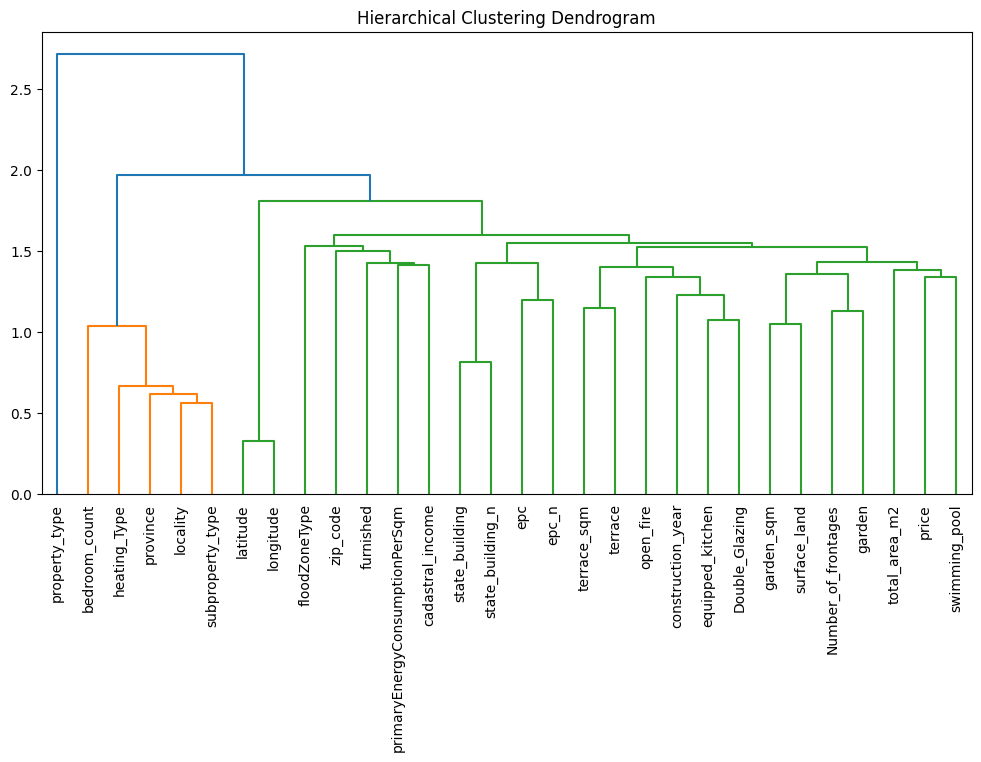

In [64]:
# Select numeric columns


numeric_columns = combined_data.select_dtypes('number')
# Replace missing values with zeros
numeric_columns_filled = numeric_columns.fillna(0)

# Calculate the correlation matrix
correlation_matrix = numeric_columns_filled.corr()

# Perform hierarchical clustering
linkage_matrix = hierarchy.linkage(correlation_matrix, method='average')

# Plot a dendrogram
plt.figure(figsize=(12, 6))
dendrogram = hierarchy.dendrogram(linkage_matrix, labels=correlation_matrix.columns, leaf_rotation=90)
plt.title('Hierarchical Clustering Dendrogram')
plt.show()


<Figure size 640x480 with 0 Axes>

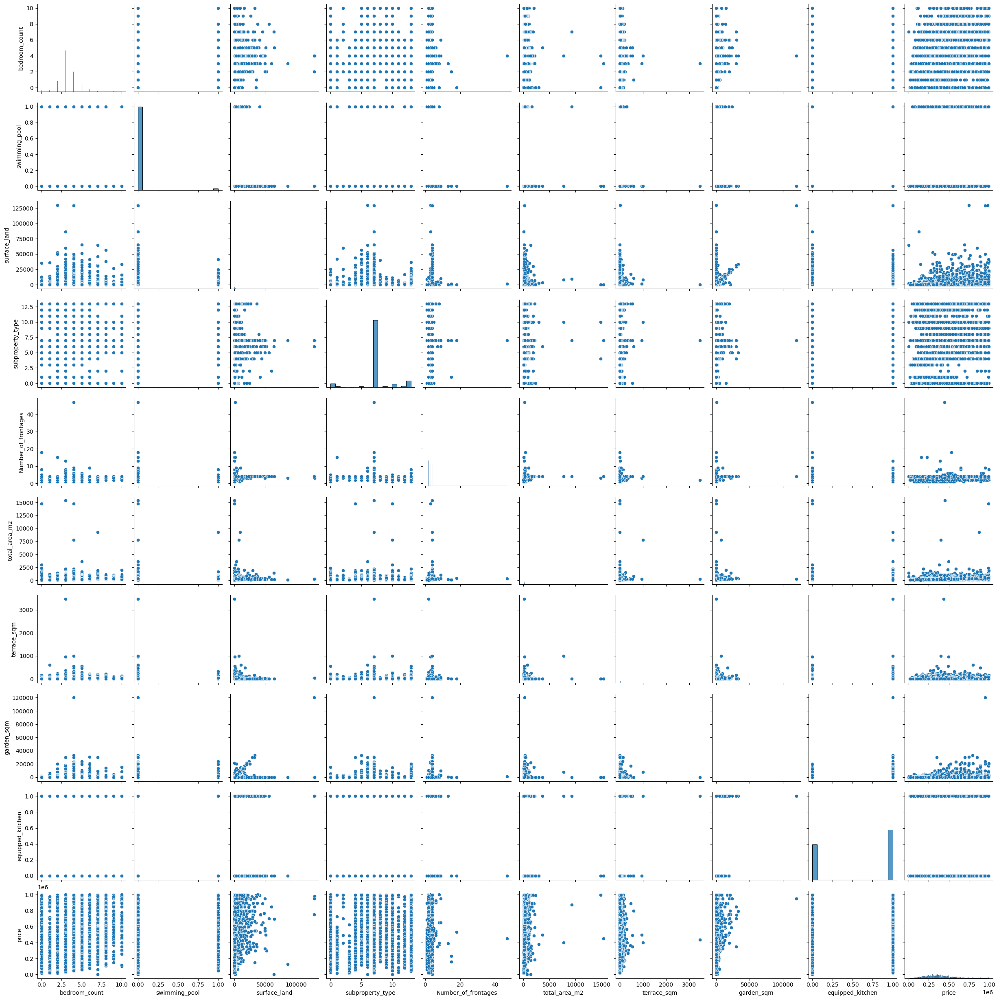

In [49]:
plt.tight_layout()
sns.pairplot(combined_data, vars=['bedroom_count', 'swimming_pool', 'surface_land', 'subproperty_type', 'Number_of_frontages', 'total_area_m2', 'terrace_sqm', 'garden_sqm', 'equipped_kitchen', 'price'])
plt.show()


# What is the correlation between the variables and the price? Why do you think some variables are more correlated than others?

In [ ]:
#The correlation of each column with the 'price' column
top_correlations = combined_data.corr()['price'].sort_values(ascending=False).head(10)
print(top_correlations)


price                  1.000000
bedroom_count          0.352279
swimming_pool          0.191223
surface_land           0.148127
subproperty_type       0.147606
Number_of_frontages    0.143736
total_area_m2          0.135460
terrace_sqm            0.134472
garden_sqm             0.086598
equipped_kitchen       0.039790
Name: price, dtype: float64


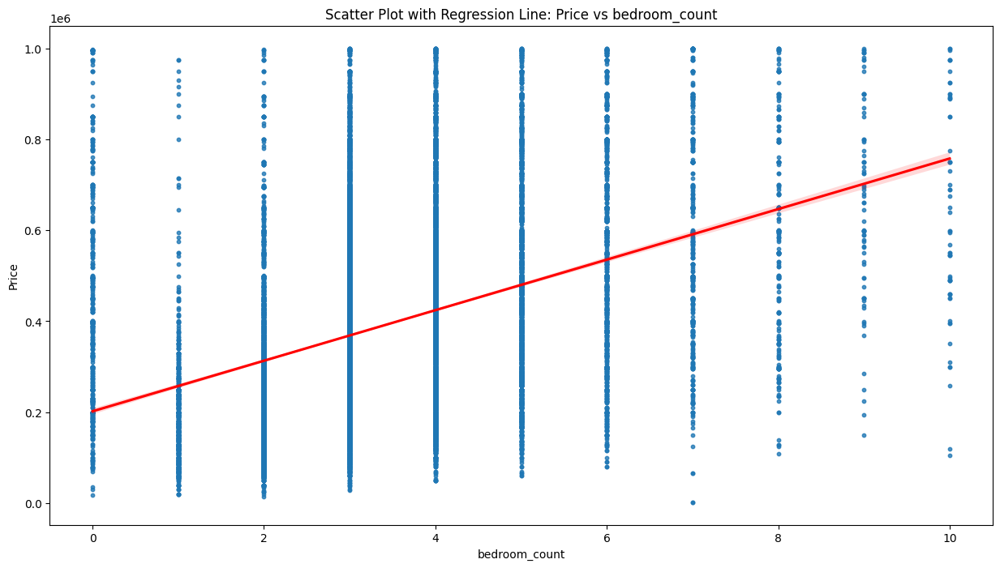

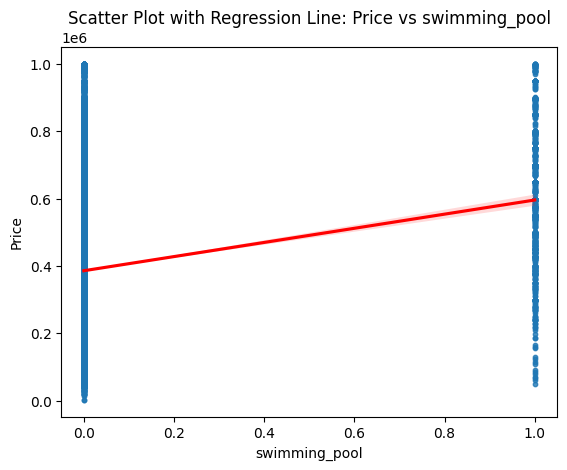

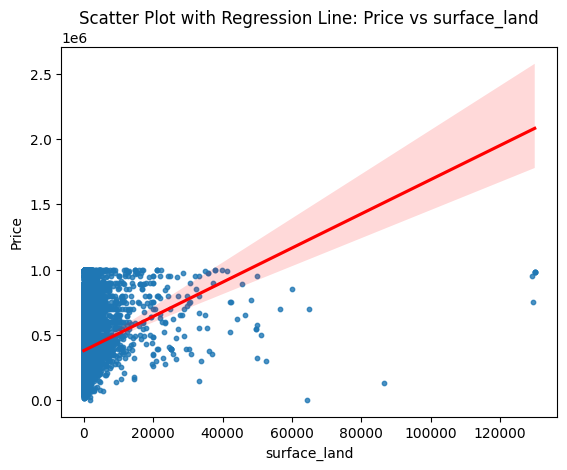

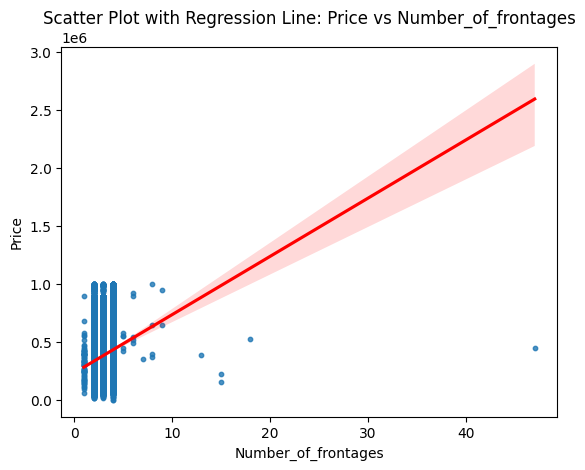

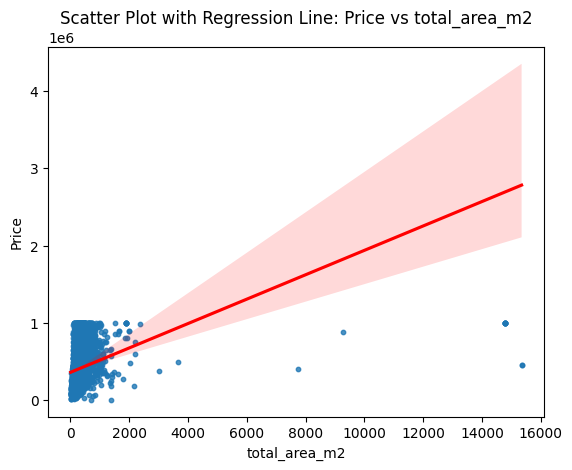

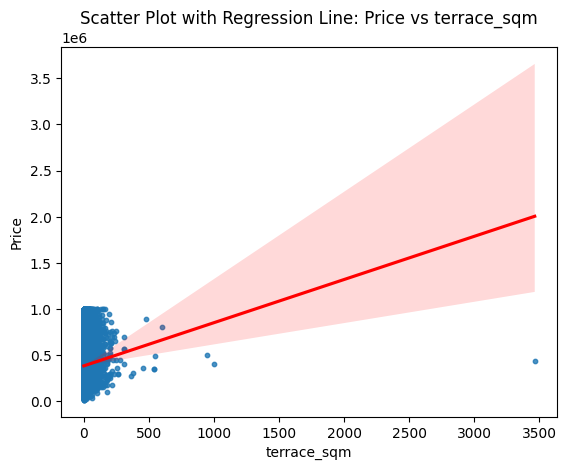

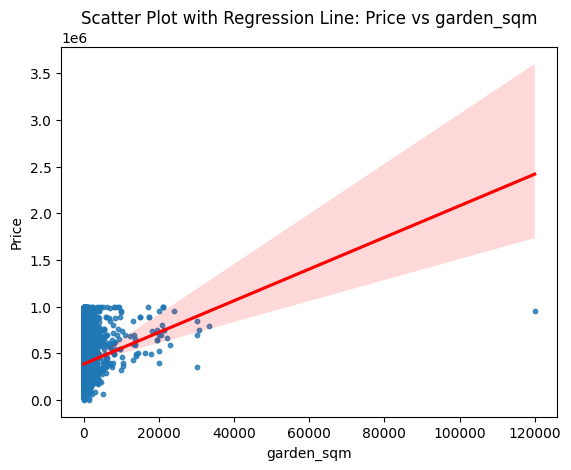

In [43]:
# Select top correlated variables with 'price'
top_variables = ['bedroom_count', 'swimming_pool', 'surface_land', 'Number_of_frontages','total_area_m2','terrace_sqm','garden_sqm']

# Create scatter plots with regression lines for each variable
plt.figure(figsize=(15, 8))
for variable in top_variables:
    sns.regplot(x=variable, y='price', data=combined_data, scatter_kws={'s': 10}, line_kws={'color': 'red'})
    plt.title(f'Scatter Plot with Regression Line: Price vs {variable}')
    plt.xlabel(variable)
    plt.ylabel('Price')
    plt.show()


# How are the number of properties distributed according to their surface?


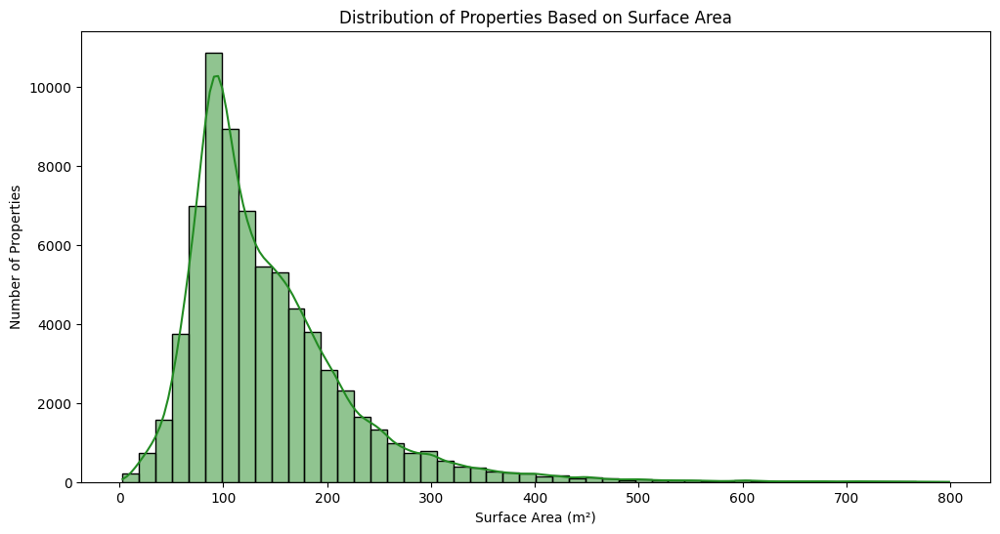

In [35]:
plt.figure(figsize=(12, 6))
sns.histplot(combined_data[combined_data['total_area_m2'] < 800]['total_area_m2'], bins=50, kde=True, color='forestgreen')
plt.title('Distribution of Properties Based on Surface Area')
plt.xlabel('Surface Area (m²)')
plt.ylabel('Number of Properties')
plt.show()


In [25]:
import plotly.express as px

brussels_data = immo_c.dropna(subset=['latitude', 'longitude'])

fig = px.scatter_mapbox(
    brussels_data,
    lat='latitude',
    lon='longitude',
    color='price',
    color_continuous_scale='blues',  # You can choose a different color scale
    hover_data=['price', 'epc', 'zip_code', 'bedroom_count'],
    size_max=60,  # You can adjust this maximum size
    mapbox_style="open-street-map",
    zoom=10,
)

fig.update_layout(mapbox_style="open-street-map")

fig.show()

In [24]:
import plotly.express as px

brussels_data = immo_c.dropna(subset=['latitude', 'longitude'])

fig = px.scatter_mapbox(
    brussels_data,
    lat='latitude',
    lon='longitude',
    color='bedroom_count',  # Color based on 'bedroom_count'
    color_continuous_scale='blues',  # You can choose a different color scale
    size='price',  # Size based on 'price'
    hover_data=['price', 'epc', 'zip_code', 'bedroom_count', 'property_type'],
    size_max=10,  # You can adjust this maximum size
    mapbox_style="open-street-map",
    zoom=10,
)

# Create a separate trace for houses
houses_data = brussels_data[brussels_data['property_type'] == 'HOUSE']
fig.add_trace(
    px.scatter_mapbox(
        houses_data,
        lat='latitude',
        lon='longitude',
        color='bedroom_count',
        size='price',
        size_max=10,
    ).data[0]
)

# Create a separate trace for apartments
apartments_data = brussels_data[brussels_data['property_type'] == 'APARTMENT']
fig.add_trace(
    px.scatter_mapbox(
        apartments_data,
        lat='latitude',
        lon='longitude',
        color='bedroom_count',
        size='price',
        size_max=10,
    ).data[0]
)

fig.update_layout(mapbox_style="open-street-map")

fig.show()


i

In [23]:
immo_c['property_type'].value_counts()

property_type
0    34957
Name: count, dtype: int64